#Overview
- How to build baseline regression model?
- How is Linear Regression model Trained?
    - SGDRegressor Estimator and random seed
    - feature scaling for SGDRegressor?
    - Shuffle and learning Rate.
    - Set Epochs
    - Stoping Creteria
    - Loss
    - Avg SGD
    - Intilisation
    - Access weights
    - Prediction
- Model Evaluation
    - R_Squared Error
    - Evaluation Metrics
    - Scores and Errors
    - CV, LeaveOneOut, ShuffleSplit
    - test and train scores from different folds
    - multiple metrics
    - Number of Samples
    - Steps

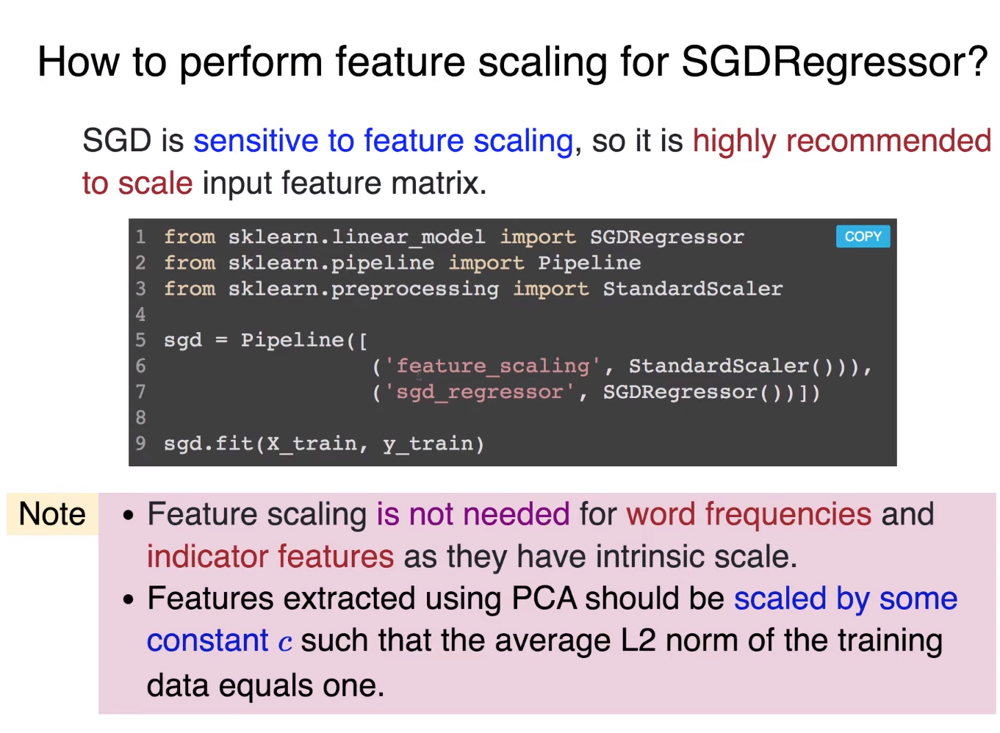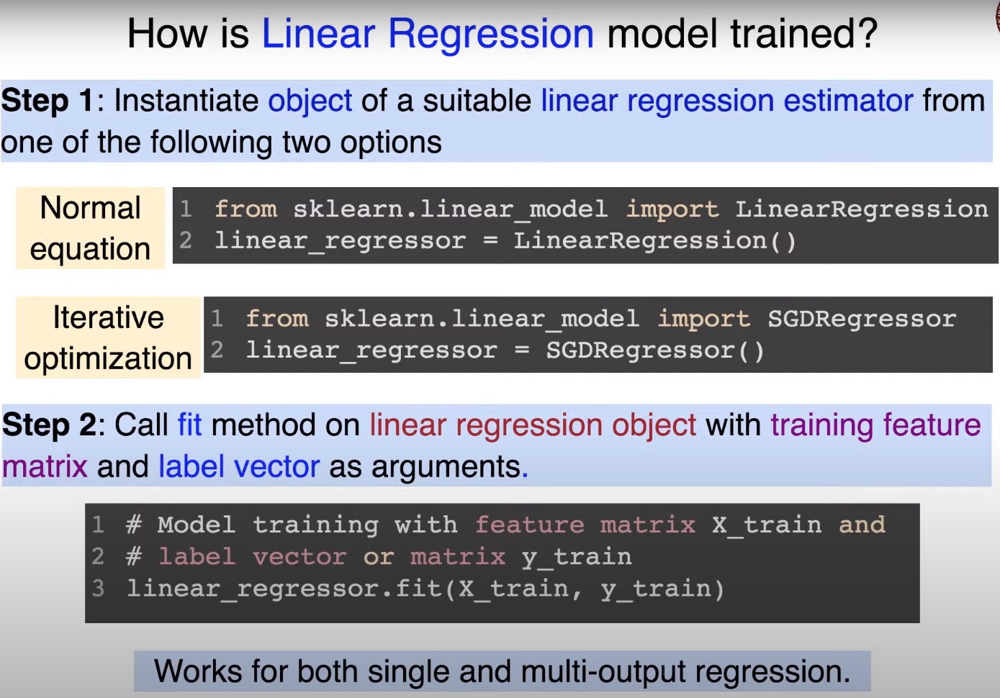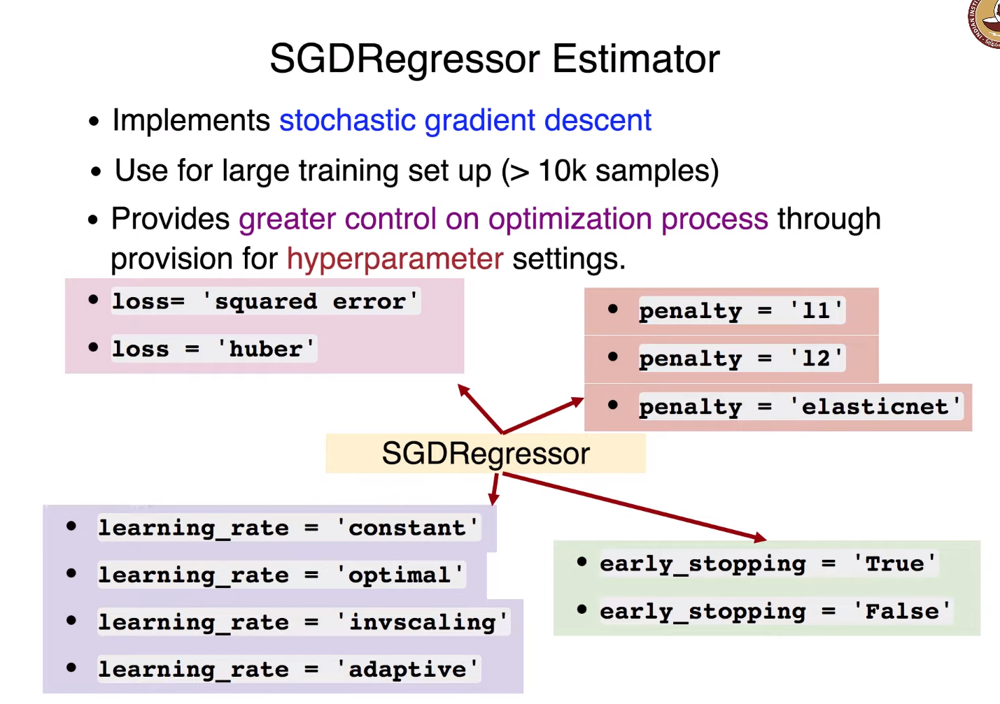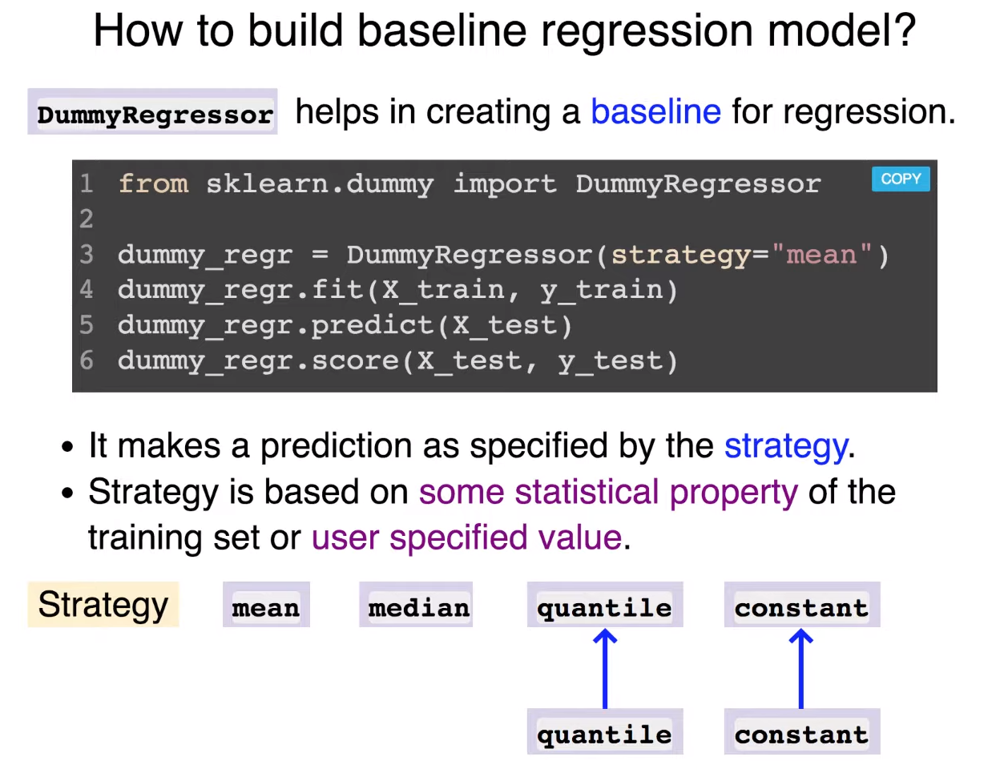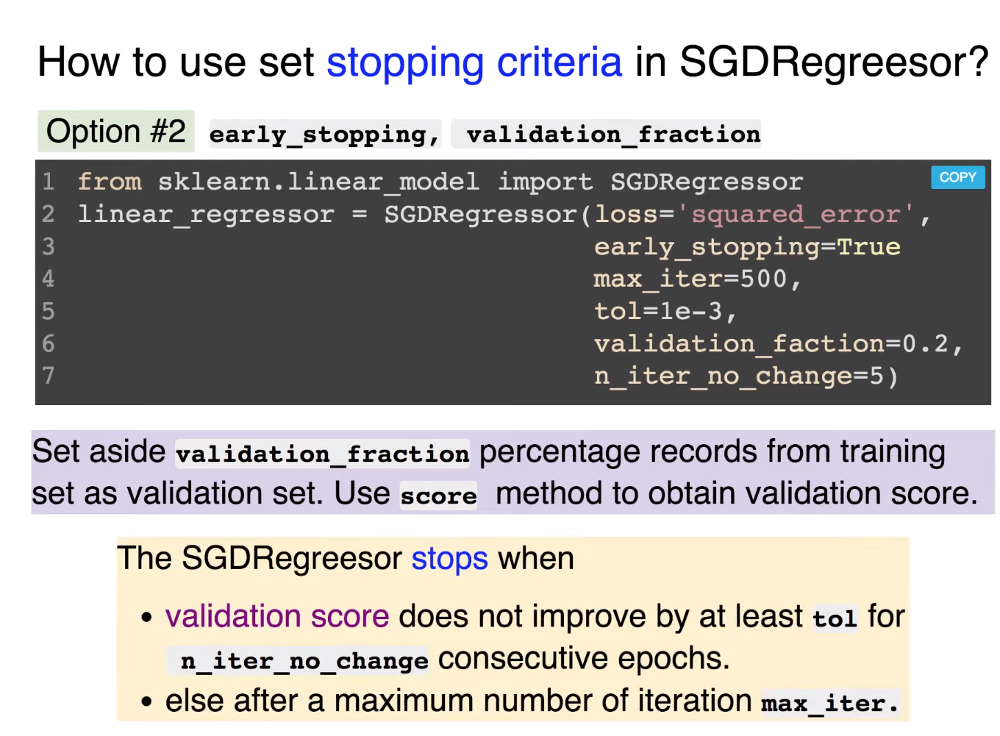
...
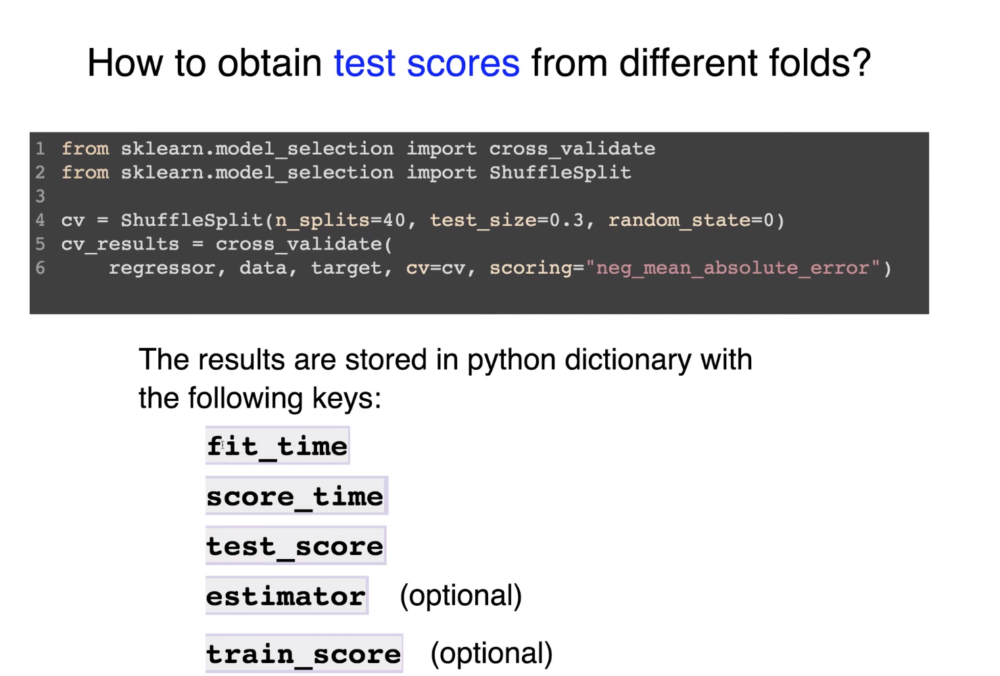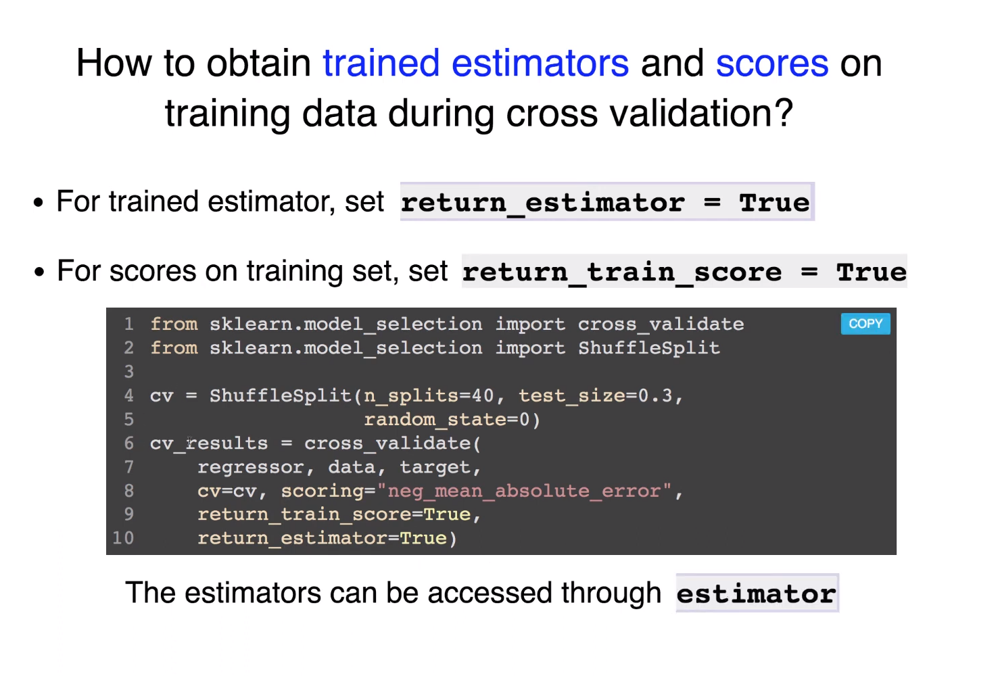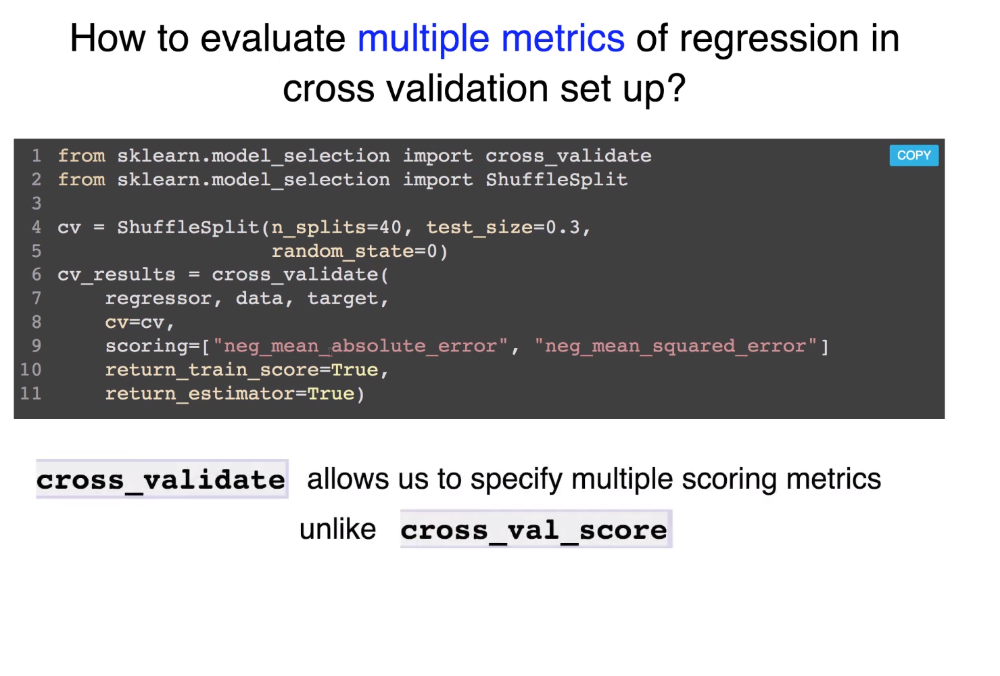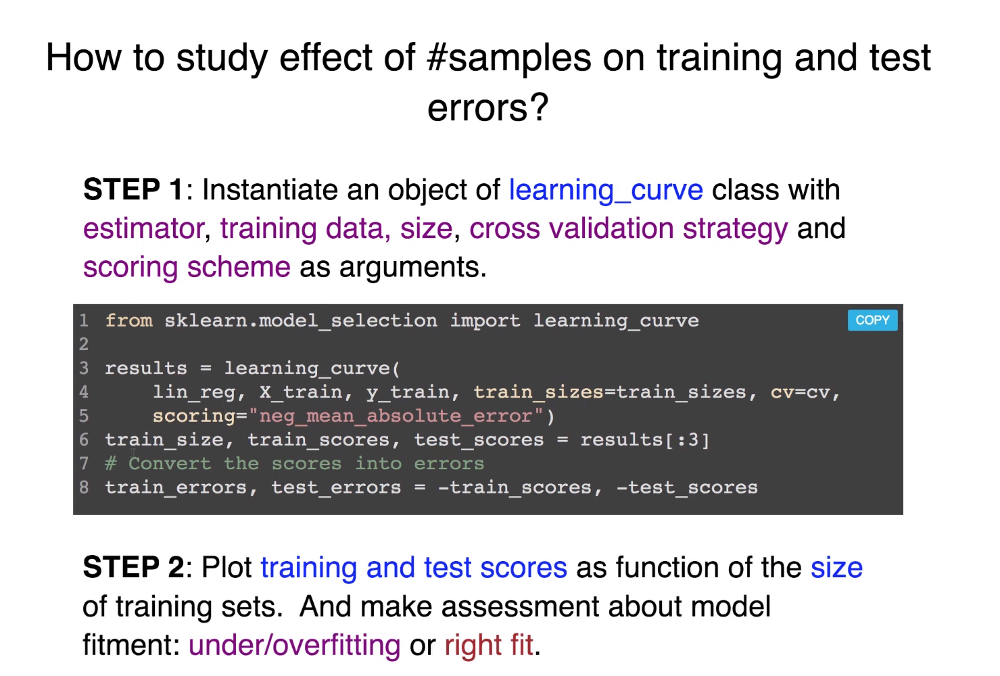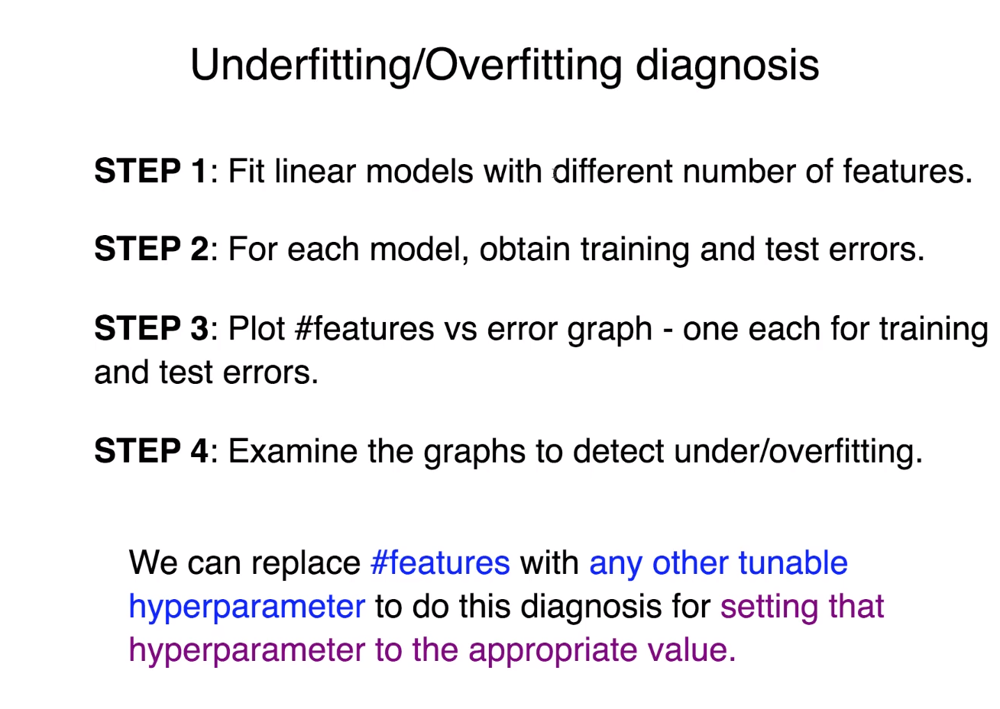

In [2]:
#Imports

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.datasets import fetch_california_housing
from sklearn.linear_model import LinearRegression

from sklearn.model_selection import cross_validate
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_predict

from sklearn.metrics import mean_squared_error

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

In [3]:
np.random.seed(306)
plt.style.use('seaborn')

/tmp/ipykernel_59036/959965024.py:2: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn')


In [4]:
shuffle_split_cv = ShuffleSplit(n_splits=10, test_size=0.2, random_state=0)


In [5]:
features, labels = fetch_california_housing(as_frame=True,return_X_y=True)

In [6]:
print("shape of feature matrix: ", features.shape)
print("shape of label matrix: ", labels.shape)

shape of feature matrix:  (20640, 8)
shape of label matrix:  (20640,)


In [7]:
assert(features.shape[0] == labels.shape[0])
#sanity check

In [8]:
# Data Exploration
from sklearn.model_selection import train_test_split
train_features, test_features, train_labels, test_labels = train_test_split(features,labels,random_state=42)
# just a single split
# features and labels 

In [10]:
# sanity check
print("# training samples: ", train_features.shape[0])
print("# training samples: ", test_features.shape[0])

# training samples:  15480
# training samples:  5160


In [11]:
assert (train_features.shape[0] == train_labels.shape[0])
assert (test_features.shape[0] == test_labels.shape[0])
#same shape for features and labels

In [14]:
#set up the linear regression model
lin_reg_pipeline = Pipeline([('feature_scaling',StandardScaler()), # Scaling
                             ('lin_reg',LinearRegression()) # Normal equation closed form
                            ])
lin_reg_pipeline.fit(train_features,train_labels) # pass training data

Pipeline(steps=[('feature_scaling', StandardScaler()),
                ('lin_reg', LinearRegression())])

In [15]:
# whatever the split i did above i apply lin reg closed form solution using pipeline then see wo and Wis

print("Intercept (w_0):", lin_reg_pipeline[-1].intercept_) # intercept through intercept_ last value of pipeline hence fetch last value
print("Weight vector (w_1,....., w_m):", lin_reg_pipeline[-1].coef_) # rest of the weights through weight_

Intercept (w_0): 2.0703489205426377
Weight vector (w_1,....., w_m): [ 0.85210815  0.12065533 -0.30210555  0.34860575 -0.00164465 -0.04116356
 -0.89314697 -0.86784046]


In [16]:
#Evaluate model performance in the test set.add
# matrix -> scale -> predict -> score by default R_squared
test_score = lin_reg_pipeline.score(test_features, test_labels)
print("Model performance on test set: ", test_score)

train_score = lin_reg_pipeline.score(train_features, train_labels)
print("Model performance on train set: ", train_score)
# underfitting
# we did for that single split 

Model performance on test set:  0.5910509795491352
Model performance on train set:  0.609873031052925


In [24]:
# as we did on one fold it was not robust so to do robust

lin_reg_score = cross_val_score(lin_reg_pipeline,
                                train_features,
                                train_labels,
                                scoring = 'neg_mean_squared_error',
                                cv = shuffle_split_cv)

#This will print 10 different scores, one for each score
print(lin_reg_score)

# We can take the mean and standard deviation of the score and report it.
print(f"\nScore of linear regression model on the test set: \n"
        f"{lin_reg_score.mean():.3f} +/- {lin_reg_score.std():.3f}")
lin_reg_mse =  -lin_reg_score
print(f"\nMSE of  linear regression model on the test set: \n"
        f"{lin_reg_mse.mean():.3f} +/- {lin_reg_mse.std():.3f}")

[-0.50009976 -0.52183352 -0.55931218 -0.52110499 -0.56059203 -0.50510767
 -0.52386194 -0.54775518 -0.5007161  -0.54713448]

Score of linear regression model on the test set: 
-0.529 +/- 0.022

MSE of  linear regression model on the test set: 
0.529 +/- 0.022


In [25]:
# to get detailed verion of everything
lin_reg_cv_results = cross_validate(lin_reg_pipeline,
                                    train_features,
                                    train_labels,
                                    cv = shuffle_split_cv,
                                    scoring="neg_mean_squared_error",
                                    return_train_score=True,
                                    return_estimator=True)

In [19]:
lin_reg_cv_results

{'fit_time': array([0.00632882, 0.01196146, 0.00923038, 0.05291986, 0.00878668,
        0.02110863, 0.02110648, 0.00786734, 0.00831342, 0.00798416]),
 'score_time': array([0.00183105, 0.01783252, 0.00287724, 0.01620865, 0.00362515,
        0.00541019, 0.00530529, 0.00222421, 0.00349545, 0.00208807]),
 'estimator': [Pipeline(steps=[('feature_scaling', StandardScaler()),
                  ('lin_reg', LinearRegression())]),
  Pipeline(steps=[('feature_scaling', StandardScaler()),
                  ('lin_reg', LinearRegression())]),
  Pipeline(steps=[('feature_scaling', StandardScaler()),
                  ('lin_reg', LinearRegression())]),
  Pipeline(steps=[('feature_scaling', StandardScaler()),
                  ('lin_reg', LinearRegression())]),
  Pipeline(steps=[('feature_scaling', StandardScaler()),
                  ('lin_reg', LinearRegression())]),
  Pipeline(steps=[('feature_scaling', StandardScaler()),
                  ('lin_reg', LinearRegression())]),
  Pipeline(steps=[('featu

In [20]:
train_error = -1 * lin_reg_cv_results['train_score'] # from score to error
test_error = -1 * lin_reg_cv_results['test_score'] # from score to error

print(f"Mean squareed error of linear regression model on the train set:\n"
        f"{train_error.mean():.3f} +/- {train_error.std():.3f}")

print(f"Mean squareed error of linear regression model on the test set:\n"
        f"{test_error.mean():.3f} +/- {test_error.std():.3f}")

Mean squareed error of linear regression model on the train set:
0.519 +/- 0.006
Mean squareed error of linear regression model on the test set:
0.529 +/- 0.022


In [26]:
# Function for visualisation

def plot_learning_curve(train_sizes, train_scores, test_scores):

    train_scores_mean = np.mean(-train_scores, axis=1)
    train_scores_std = np.std(-train_scores, axis=1)
    test_scores_mean = np.mean(-test_scores, axis=1)
    test_scores_std = np.std(-test_scores, axis=1)

    plt.fill_between(
            train_sizes,
            train_scores_mean - train_scores_std,
            train_scores_mean + train_scores_std,
            alpha = 0.1,
            color = "r",)

    plt.fill_between(
            train_sizes,
            test_scores_mean - test_scores_std,
            test_scores_mean + test_scores_std,
            alpha = 0.1,
            color = "g",)

    plt.plot(train_sizes, train_scores_mean, "o-", color="r", label="Training score")
    plt.plot(train_sizes, test_scores_mean, "o-", color="g", label="Cross-validation score")
    plt.xlabel("Training examples")
    plt.ylabel("MSE")
    plt.legend(loc="best")

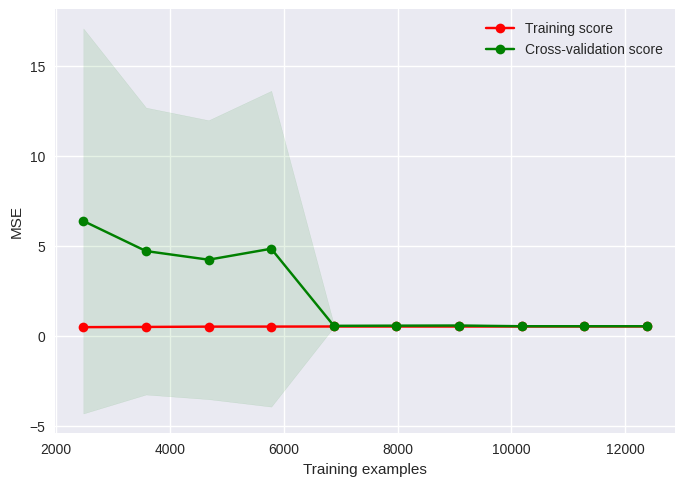

In [27]:
(train_sizes, train_scores, test_scores, fit_times, score_times) = learning_curve(lin_reg_pipeline, #pipeline
                                                                                    train_features,
                                                                                    train_labels,
                                                                                    cv=shuffle_split_cv,
                                                                                    scoring='neg_mean_squared_error',
                                                                                    n_jobs=-1,# parrlroism
                                                                                    return_times=True,
                                                                                    train_sizes=np.linspace(0.2, 1.0, 10))

plot_learning_curve(train_sizes, train_scores, test_scores)

observations:

* Both curves have reached a plateau" They are close and fairly high.
* Few instances in the training set mean the model can fit them perfectly. But as more instances are added to the training set, it becomes impossible for the model to fit the training data perfectly.
* When the model is trained on very few instances, it is not able to generalize properly, hence the validation error is high.

These learning curves are typical of underfitting model

In [28]:
feature_names = train_features.columns
feature_names

Index(['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup',
       'Latitude', 'Longitude'],
      dtype='object')

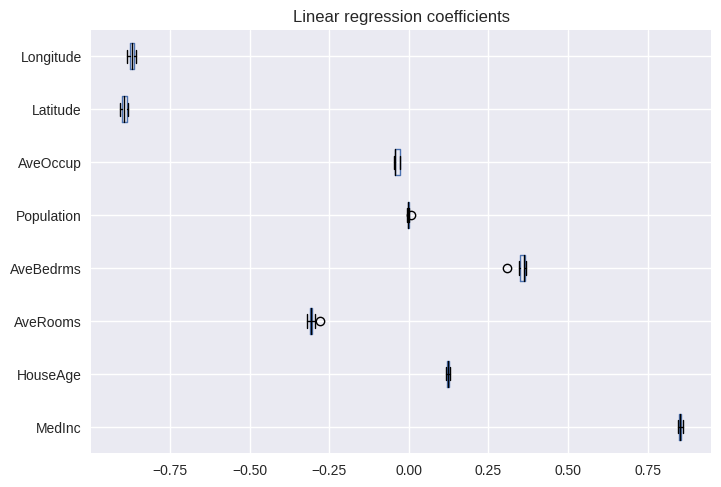

In [29]:
coefs = [est[-1].coef_ for est in lin_reg_cv_results["estimator"]]
weights_df = pd.DataFrame(coefs, columns=feature_names)

color = {"whiskers": "black", "medians": "black", "caps": "black"}
weights_df.plot.box(color=color, vert=False)
_ = plt.title("Linear regression coefficients")
# box plot gives variablity

In [30]:
weights_df.describe()
# variance is higher in

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
count,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
mean,0.852153,0.122770,-0.304384,0.353528,-0.001576,-0.037059,-0.894011,-0.869753
std,0.005763,0.004312,0.010998,0.018044,0.003254,0.008582,0.009975,0.009097
min,0.843517,0.117394,-0.318971,0.307474,-0.005787,-0.047584,-0.908058,-0.884206
25%,0.848871,0.119895,-0.310778,0.349715,-0.002688,-0.042486,-0.901411,-0.876542
50%,0.852711,0.121592,-0.305795,0.360139,-0.002063,-0.042325,-0.895370,-0.869631
75%,0.854743,0.125520,-0.302980,0.364646,-0.000350,-0.027562,-0.883967,-0.862110
max,0.861659,0.130560,-0.278426,0.367952,0.005297,-0.026331,-0.881884,-0.857844


In [31]:
best_model_index = np.argmin(test_error)
selected_model = lin_reg_cv_results['estimator'][best_model_index]

# from  the cv results

In [32]:
print("Intercept (w_0):", selected_model['lin_reg'].intercept_) # intercept through intercept_
print("Weight vector (w_1,....., w_m):", selected_model['lin_reg'].coef_) # rest of the weights through weight_

Intercept (w_0): 2.0779898917958657
Weight vector (w_1,....., w_m): [ 8.44324888e-01  1.18463901e-01 -3.04619574e-01  3.56620503e-01
  1.74458509e-04 -4.23964612e-02 -8.96045642e-01 -8.68906479e-01]


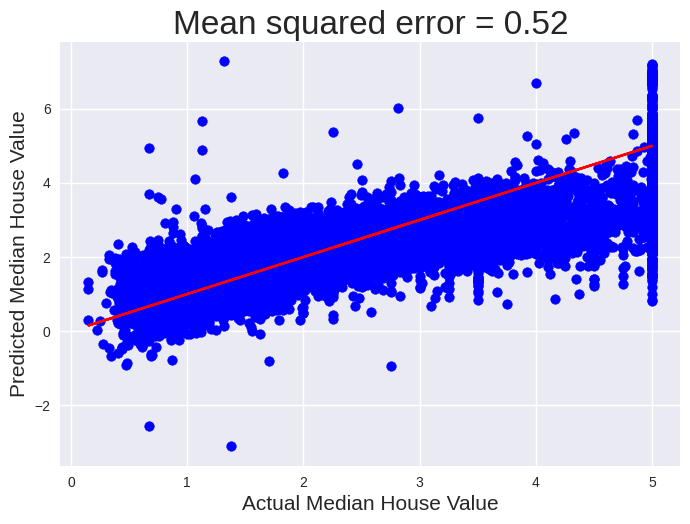

In [33]:
cv_predictions = cross_val_predict(lin_reg_pipeline, train_features, train_labels)

mse_cv = mean_squared_error(train_labels, cv_predictions)

plt.scatter(train_labels, cv_predictions, color='blue')
plt.plot(train_labels, train_labels, 'r-')
plt.title(f"Mean squared error = {mse_cv:.2f}", size=24)
plt.xlabel("Actual Median House Value", size=15)
plt.ylabel("Predicted Median House Value", size=15)
plt.show()

In [34]:
test_predictions_cv = selected_model.predict(test_features)
test_predictions_cv[:5]

array([0.73548515, 1.7725621 , 2.70011199, 2.83716602, 2.60743151])

In [35]:
test_predictions = lin_reg_pipeline.predict(test_features)
test_predictions[:5]

array([0.72412832, 1.76677807, 2.71151581, 2.83601179, 2.603755  ])

In [37]:
score_cv = selected_model.score(test_features, test_labels)
score = lin_reg_pipeline.score(test_features, test_labels)

print("R2 score for the best model obtained via cross validation: ", score_cv)
print("R2 score for the model without cross validation: ", score)
#Cross validated models have slightly better results

R2 score for the best model obtained via cross validation:  0.5923577635319087
R2 score for the model without cross validation:  0.5910509795491352


In [38]:
from sklearn.dummy import DummyRegressor
from sklearn.model_selection import permutation_test_score

In [47]:
shuffle_split_cv
features, labels = fetch_california_housing(as_frame=True, return_X_y=True)
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, random_state=42)


In [48]:
lin_reg_pipeline = Pipeline([("feature_scaling", StandardScaler()),
                                ("lin_reg", LinearRegression())])

lin_reg_cv_results = cross_validate(lin_reg_pipeline, train_features,
                                    train_labels, cv=shuffle_split_cv,
                                    scoring="neg_mean_squared_error",
                                    n_jobs=2)

lin_reg_errors = pd.Series(-lin_reg_cv_results["test_score"],
                            name="Linear regression error")

In [49]:
# function for dummy regressor
def dummy_regressor_baseline(strategy, constant_val=None, quantile_val=None):
    
    baseline_model_median = DummyRegressor(strategy=strategy,
                                            constant=constant_val,
                                            quantile=quantile_val)

    baseline_median_cv_results = cross_validate(baseline_model_median,
                                                train_features, train_labels,
                                                cv=shuffle_split_cv,
                                                scoring="neg_mean_absolute_error",
                                                n_jobs=2)
    
    return pd.Series(-baseline_median_cv_results["test_score"],
                            name="Dummy regressor error")

In [50]:
baseline_median_cv_results_error = dummy_regressor_baseline(strategy = 'median')
baseline_mean_cv_results_error = dummy_regressor_baseline(strategy = 'mean')
baseline_constant_cv_results_error = dummy_regressor_baseline(strategy = 'constant', constant_val=2)
baseline_quantile_cv_results_error = dummy_regressor_baseline(strategy = 'quantile', quantile_val=0.55)

In [51]:
dummy_error_df = pd.concat([baseline_median_cv_results_error,
                            baseline_mean_cv_results_error,
                            baseline_constant_cv_results_error,
                            baseline_quantile_cv_results_error],
                            axis=1)
            
dummy_error_df.columns = ['Median cv', 'Mean cv', 'Constant cv', 'Quantile cv']

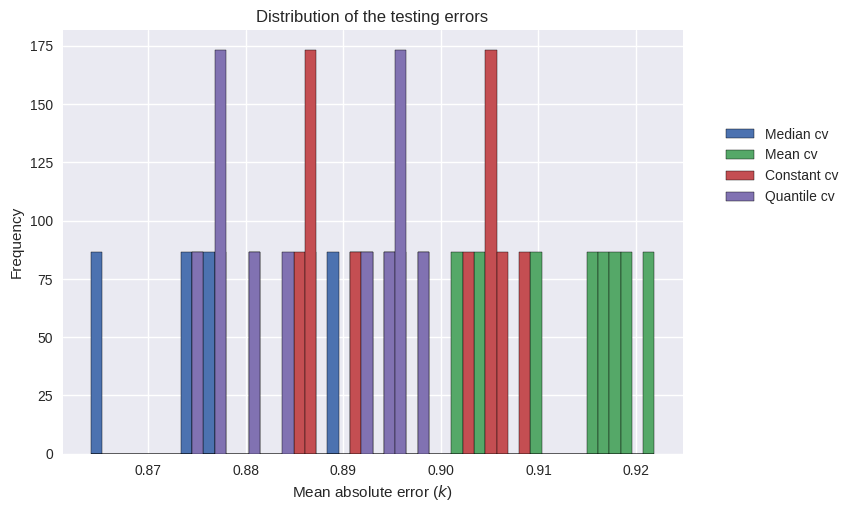

In [52]:
dummy_error_df.plot.hist(bins=50, density=True, edgecolor="black")
plt.legend(bbox_to_anchor=(1.05, 0.8), loc="upper left")
plt.xlabel("Mean absolute error ($k$)")
_ = plt.title("Distribution of the testing errors")

In [53]:
score, permutation_score, pvalue = permutation_test_score(lin_reg_pipeline,
                                                            train_features,
                                                            train_labels,
                                                            cv=shuffle_split_cv,
                                                            scoring="neg_mean_absolute_error",
                                                            n_jobs=2, n_permutations=30)

permutation_errors = pd.Series(-permutation_score, name="Permuted error")

print(permutation_score)

[-0.91446539 -0.91608713 -0.91501122 -0.91112203 -0.91326112 -0.91428719
 -0.91694297 -0.90660687 -0.90873595 -0.91546138 -0.9084695  -0.91174023
 -0.91857102 -0.91467076 -0.90396709 -0.91239289 -0.91095499 -0.91729623
 -0.90529415 -0.91436609 -0.91993036 -0.91661883 -0.91104746 -0.91563156
 -0.91014294 -0.91526135 -0.90680247 -0.90796435 -0.91032999 -0.91545574]


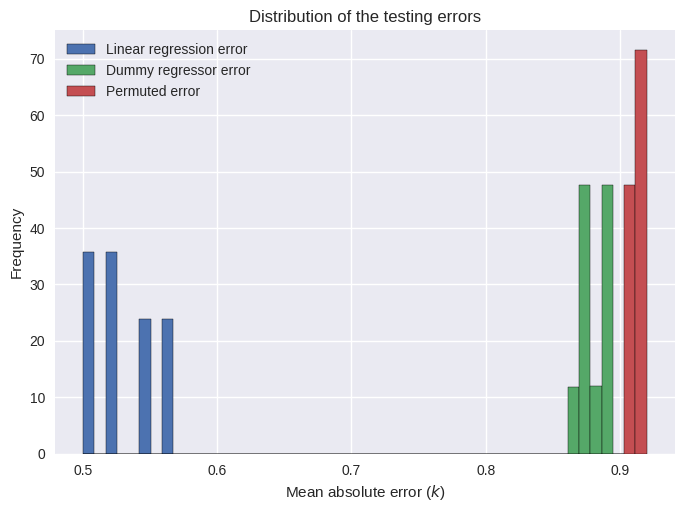

In [54]:
error_df = pd.concat([lin_reg_errors, baseline_median_cv_results_error, permutation_errors],
                        axis = 1)

error_df.plot.hist(bins=50, density=True, edgecolor="black")
plt.legend(loc="best")
plt.xlabel("Mean absolute error ($k$)")
_ = plt.title("Distribution of the testing errors")